In [1]:
import pandas as pd
from janome.tokenizer import Tokenizer
from wordcloud import WordCloud
import matplotlib.pyplot as plt

In [2]:
# CSVファイルを読み込み
file_path = 'Awich_songs_df.csv'
# 正しいエンコーディングを指定
df = pd.read_csv(file_path, encoding='cp932')
#print(df.head())

In [3]:
import os
import pandas as pd

# ファイルパスの設定
main_dir = '/mnt/data'
file_path = os.path.join('Awich_songs_df.csv')

# CSVファイルの読み込み
song_df = pd.read_csv(file_path, encoding='shift_jis')

# song_idを一番左に持ってくる
song_df['song_id'] = song_df.index + 1
song_df = song_df[['song_id', 'song_name', 'lyrics']]

# song_dfを転置してから辞書化する
song_df_t = song_df[['song_name', 'lyrics']].T
song_df_t.columns = song_df['song_id']
song_dict = song_df_t.to_dict()

# 辞書の構成を確認
for key, val in song_dict[1].items():
    print('◆{}:'.format(key), val)

# song_id を 3 桁にフォーマット
song_df['song_id'] = song_df['song_id'].apply(lambda x: f'{x:03}')

# song_df を転置してから辞書化
song_df_t = song_df[['song_name', 'lyrics']].T
song_df_t.columns = song_df['song_id']
song_dict = song_df_t.to_dict()

# song_id リストの確認
song_id_list = list(song_dict.keys())
print(song_id_list[:5])

◆song_name: Awake
◆lyrics: Pandemic Plandemic地球よ　are you ready？消えてくmoney　増えてく闇誰が敵で、誰が family？Fathers がいない子供達Mothers を責めて指を刺し悪魔は boys & girls に hush恐怖に怯える面差しSo, where we going？ Where we going？ハーメルンの笛の鳴る方に連れて行かれないように握る小さな手 of ToyomiAnd I tell her love is the answerMay be we are the cancer誰のための riot？裏で糸引く liarsParadox Paradox投げ合う苦しみの rocksなぜ人は奪い、壊し、争い、忘れてる、全ては one分けることができないこと分かることで、分かち合う生まれる　free energy陰と陽の　beautiful synergy分裂する　black brown and yellowFirst class, middle class and ghetto10%が作る線を残りはあくせくと swallowNano レベルの tricknology6 for equal qualities団結は majority繋ないでく灯火thanks to the earth　thanks to the sunthanks to the moon　thanks to the wombthanks to the mind　thanks to the artthanks to the life　thanks to the heartThanks for the love yeaHERE and NOW からもう逃げないNo more　ないものねだり愛という名の Ammoで run itWe're coming and gunning女神たちの気配背負う願い時に目眩するほど長い道のりも粘りLook、　エゴを許し、愛を選び集うジェダイ、命を照らしShare the legacy、めくるメカニズムの得体解ける世界この歌詞をマイ歌ネットに登録>このアーティストをマイ歌ネットに登録>
['001', '002', '003', '004', '005']


In [4]:
import re
import unicodedata
from janome.tokenizer import Tokenizer
import nltk
from nltk.corpus import stopwords
from nltk import pos_tag, word_tokenize

# nltkのデータをダウンロード
nltk.download('punkt')
nltk.download('averaged_perceptron_tagger')
nltk.download('stopwords')

# 形態素解析のためのトークナイザー
t = Tokenizer()

# 残したい日本語の品詞のリスト
pos_list = ['名詞', '形容詞', '副詞', '動詞', '連体詞', '接続詞']

# 英語の品詞のマッピング
pos_map = {
    'NN': '名詞', 'JJ': '形容詞', 'RB': '副詞', 'VB': '動詞',
    'DT': '連体詞', 'IN': '接続詞', 'PRP': '代名詞', 'CC': '接続詞'
}

# 英語の単語を抽出する正規表現
english_word_re = re.compile(r'[a-zA-Z]+')

# 分かち書きされた単語を正規化し、不要文字列を除外するための関数
def wd_cleaning(wd):
    # 文字列の正規化（全角を半角へ、アルファベットは小文字にする）
    wd = unicodedata.normalize('NFKC', wd).lower()
    # 不要文字列を''に置換するための正規表現（アルファベット、改行コード、記号など）
    code_regex = re.compile(r'[0-9#&!,?\'()~\-...…;:“]')
    cleaned_wd = code_regex.sub('', wd)
    return cleaned_wd

# 歌詞を形態素解析するための関数
def lyric_cleaning(lyric):
    # 英語の単語を抽出
    english_words = english_word_re.findall(lyric)
    english_words = [word.lower() for word in english_words if wd_cleaning(word) != '']

    # 日本語の形態素解析を行い、指定した品詞に限り、[単語の原形, 品詞]のセットをリストで返す
    lyric_sep = [[wd.base_form, wd.part_of_speech.split(",")[0]] for wd in t.tokenize(lyric) if wd.part_of_speech.split(",")[0] in pos_list]

    # 英語の品詞タグ付けを行う
    english_tags = pos_tag(english_words)
    english_tags = [(word, pos_map.get(tag[:2], 'その他')) for word, tag in english_tags]

    # 不要文字列を除外
    lyric_sep = [wd for wd in lyric_sep if wd_cleaning(wd[0]) != '']
    # 改行コードが除外しきれていないことがあるので、含まれている場合は除外する
    lyric_sep = [wd for wd in lyric_sep if '\u3000' not in wd[0]]
    # 意味をなさない言葉が残ることがあるので、除外する
    kana_list = [chr(i) for i in range(12353, 12436)]
    stopwds_list = kana_list + ['ー', 'する', 'いる', 'てる', 'なる', 'れる', 'られる', 'せる']
    lyric_sep = [wd for wd in lyric_sep if wd[0] not in stopwds_list]

    # 英語の単語を追加
    lyric_sep.extend(english_tags)

    return lyric_sep

# 例として、歌詞をクレンジングしてみる
sample_lyric = "Pandemic Plandemic地球よ　are you ready？消えてくmoney　増えてく闇誰が敵で、誰が family？Fathers がいない子供達Mothers を責めて指を刺し悪魔は boys & girls に hush恐怖に怯える面差しSo, where we going？"
cleaned_lyric = lyric_cleaning(sample_lyric)
print(cleaned_lyric)


[nltk_data] Downloading package punkt to /Users/uma.palm/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /Users/uma.palm/nltk_data...
[nltk_data]   Unzipping taggers/averaged_perceptron_tagger.zip.
[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/uma.palm/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


[['Pandemic', '名詞'], ['Plandemic', '名詞'], ['地球', '名詞'], ['are', '名詞'], ['you', '名詞'], ['ready', '名詞'], ['消える', '動詞'], ['money', '名詞'], ['増える', '動詞'], ['闇', '名詞'], ['誰', '名詞'], ['敵', '名詞'], ['誰', '名詞'], ['family', '名詞'], ['Fathers', '名詞'], ['子供', '名詞'], ['達', '名詞'], ['Mothers', '名詞'], ['責める', '動詞'], ['指', '名詞'], ['刺す', '動詞'], ['悪魔', '名詞'], ['boys', '名詞'], ['girls', '名詞'], ['hush', '名詞'], ['恐怖', '名詞'], ['怯える', '動詞'], ['面差し', '名詞'], ['So', '名詞'], ['where', '名詞'], ['we', '名詞'], ['going', '名詞'], ('pandemic', '形容詞'), ('plandemic', '名詞'), ('are', '動詞'), ('you', 'その他'), ('ready', '形容詞'), ('money', '名詞'), ('family', '名詞'), ('fathers', '名詞'), ('mothers', '名詞'), ('boys', '動詞'), ('girls', '名詞'), ('hush', '名詞'), ('so', '副詞'), ('where', 'その他'), ('we', 'その他'), ('going', '動詞')]


In [5]:
# 各 song_id に対して歌詞を形態素解析し、辞書に追加する
for song_id in song_id_list:
    lyric = song_dict[song_id]['lyrics']

    # テキストを分かち書きし、除外指定した品詞以外の形態素を残す
    lyric_sep = lyric_cleaning(lyric)

    # 単語と品詞のリスト（集計用）と、単語を空白でjoinした文字列（モデル構築用）を、辞書に追加する
    lyric_sep_wds = [wds for wds, pos in lyric_sep]
    lyric_sep_pos = [pos for wds, pos in lyric_sep]
    song_dict[song_id]['lyric_wds'] = lyric_sep_wds
    song_dict[song_id]['lyric_pos'] = lyric_sep_pos
    song_dict[song_id]['lyric_wds_join'] = '　'.join(lyric_sep_wds)

# 辞書の構成を再確認
sample_song_id = song_id_list[0]
for key, val in song_dict[sample_song_id].items():
    print('◆{}:'.format(key), val)


◆song_name: Awake
◆lyrics: Pandemic Plandemic地球よ　are you ready？消えてくmoney　増えてく闇誰が敵で、誰が family？Fathers がいない子供達Mothers を責めて指を刺し悪魔は boys & girls に hush恐怖に怯える面差しSo, where we going？ Where we going？ハーメルンの笛の鳴る方に連れて行かれないように握る小さな手 of ToyomiAnd I tell her love is the answerMay be we are the cancer誰のための riot？裏で糸引く liarsParadox Paradox投げ合う苦しみの rocksなぜ人は奪い、壊し、争い、忘れてる、全ては one分けることができないこと分かることで、分かち合う生まれる　free energy陰と陽の　beautiful synergy分裂する　black brown and yellowFirst class, middle class and ghetto10%が作る線を残りはあくせくと swallowNano レベルの tricknology6 for equal qualities団結は majority繋ないでく灯火thanks to the earth　thanks to the sunthanks to the moon　thanks to the wombthanks to the mind　thanks to the artthanks to the life　thanks to the heartThanks for the love yeaHERE and NOW からもう逃げないNo more　ないものねだり愛という名の Ammoで run itWe're coming and gunning女神たちの気配背負う願い時に目眩するほど長い道のりも粘りLook、　エゴを許し、愛を選び集うジェダイ、命を照らしShare the legacy、めくるメカニズムの得体解ける世界この歌詞をマイ歌ネットに登録>このアーティストをマイ歌ネットに登録>
◆lyric_wds: ['Pandemic', 'Plandemic', '地球', 'are', 'y

In [6]:
# 分かち書きされた単語と品詞を抽出してリストにする
lyric_wds_list = [song_dict[song_id]['lyric_wds'] for song_id in song_id_list]
lyric_pos_list = [song_dict[song_id]['lyric_pos'] for song_id in song_id_list]
songids_list = [[song_id] * len(lyric_wds) for song_id, lyric_wds in zip(song_id_list, lyric_wds_list)]

# リストが二次元になっているので、一元化する
lyric_wds_list_flatten = sum(lyric_wds_list, [])
lyric_pos_list_flatten = sum(lyric_pos_list, [])
songids_list_flatten = sum(songids_list, [])

# データフレームにする
lyric_df = pd.DataFrame({
    'song_id': songids_list_flatten,
    'wd': lyric_wds_list_flatten,
    'pos': lyric_pos_list_flatten
})

# song_dict から曲名を取得する関数
def get_song_name(song_id):
    return song_dict[song_id]['song_name']

# 曲名をデータフレームに追加
lyric_df['song_name'] = lyric_df['song_id'].apply(get_song_name)

# 曲名×品詞ごとに単語の出現回数をカウントする
lyric_df_gp = lyric_df.groupby(['song_name', 'pos', 'wd']).size().to_frame('cnt').reset_index()
lyric_df_gp = lyric_df_gp.sort_values(by=['song_name', 'pos', 'cnt'], ascending=[True, True, False]).reset_index(drop=True)

# 曲名×品詞ごとに出現回数のランクをつける
lyric_df_gp['cnt_rank'] = lyric_df_gp.groupby(['song_name', 'pos'])['cnt'].rank(ascending=False)

# スプレッドシート形式でデータフレームを表示
import IPython.display as display
display.display(lyric_df_gp.query('pos == "形容詞"').head())

,song_name,pos,wd,cnt,cnt_rank
192,44 Bars,形容詞,無い,2,1.0
193,44 Bars,形容詞,rap,1,5.5
194,44 Bars,形容詞,yaw,1,5.5
195,44 Bars,形容詞,大きい,1,5.5
196,44 Bars,形容詞,怖い,1,5.5


In [8]:
#曲名ごとに、出現回数TOP30の単語を棒グラフで表示する関数
def wdcnt_graph_show(target_pos):

  # 指定した品詞のデータを抽出
  target_df =  lyric_df_gp.query('pos == @target_pos')

  # 曲ごとにTOP30の品詞と単語のリストを抽出してリストに格納
  ginfo_list = []
  for artist_name in artist_name_list:
    # TOP30を抽出した後、昇順で並び替え（横棒グラフで降順で表示するための処理）
    artist_df = target_df.query('artist_name == @artist_name and cnt_rank <= 30').sort_values(by='cnt',ascending=True)
    ginfo_list.append([artist_name, artist_df['wd'].tolist(), artist_df['cnt'].tolist()])

  # 曲ごとに横棒グラフで表示
  fig = plt.figure(figsize=(30,15))
  plt.suptitle('【{}における出現回数】'.format(target_pos), fontsize=30)

  for idx, ginfo in enumerate(ginfo_list):
    artist_name, wd_list, cnt_list = ginfo[0], ginfo[1], ginfo[2]

    # ランキングする単語数を取得（品詞によってはTOP30もないことがあるので）
    rank_num = len(wd_list)

    # 出現回数のラベル用
    cnt_labels = np.linspace(0, max(cnt_list), 5)
    # print(cnt_labels)
    # >>>[  0.   30.5  61.   91.5 122. ]

    # 棒グラフを描画
    ax = fig.add_subplot(1, 3, idx+1)
    ax.set_title(artist_name, fontsize=25)
    ax.barh(wd_list, cnt_list)

    # set_ytics,set_xticks：ラベルの位置を指定
    # set_yticslabels,set_xtickslabels：ラベルの値とフォントサイズを指定
    # ※set_ytics,set_xticksを指定せずに実行するとwarningが出るので注意
    ax.set_yticks(range(rank_num))
    ax.set_yticklabels(wd_list,fontsize=20)
    ax.set_xticks(cnt_labels)
    ax.set_xticklabels(cnt_labels,fontsize=20)
    ax.grid(linestyle='dotted', linewidth=1,axis='x',color="r")

  plt.show()

In [10]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib import font_manager

# 日本語フォントを設定
font_path = '/System/Library/Fonts/ヒラギノ丸ゴ ProN W4.ttc'  # ここにはシステムにインストールされている日本語フォントのパスを指定してください
font_prop = font_manager.FontProperties(fname=font_path)
plt.rcParams['font.family'] = font_prop.get_name()

# 曲名のリストを取得
song_name_list = lyric_df['song_name'].unique().tolist()

# 出現回数TOP30の単語を棒グラフで表示する関数
def wdcnt_graph_show(target_pos):
    # 指定した品詞のデータを抽出
    target_df = lyric_df_gp.query('pos == @target_pos')

    # 曲ごとにTOP30の品詞と単語のリストを抽出してリストに格納
    for song_name in song_name_list:
        # TOP30を抽出した後、昇順で並び替え（横棒グラフで降順で表示するための処理）
        song_df = target_df.query('song_name == @song_name and cnt_rank <= 30').sort_values(by='cnt', ascending=True)
        if not song_df.empty:
            wd_list = song_df['wd'].tolist()
            cnt_list = song_df['cnt'].tolist()

            # ランキングする単語数を取得（品詞によってはTOP30もないことがあるので）
            rank_num = len(wd_list)

            # 出現回数のラベル用
            if cnt_list:
                cnt_labels = np.linspace(0, max(cnt_list), 5)
            else:
                cnt_labels = []

            # 新しいプロットを作成
            fig, ax = plt.subplots(figsize=(10, 8))
            ax.set_title(f'{song_name} - {target_pos}における出現回数', fontsize=20, fontproperties=font_prop)
            ax.barh(wd_list, cnt_list)

            # ラベルの位置と値を設定
            ax.set_yticks(range(rank_num))
            ax.set_yticklabels(wd_list, fontsize=12, fontproperties=font_prop)
            ax.set_xticks(cnt_labels)
            ax.set_xticklabels(cnt_labels, fontsize=12)
            ax.grid(linestyle='dotted', linewidth=1, axis='x', color="r")

            plt.show()


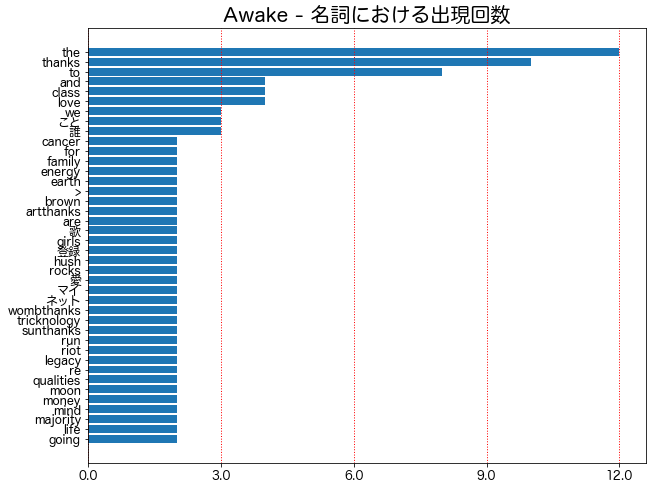

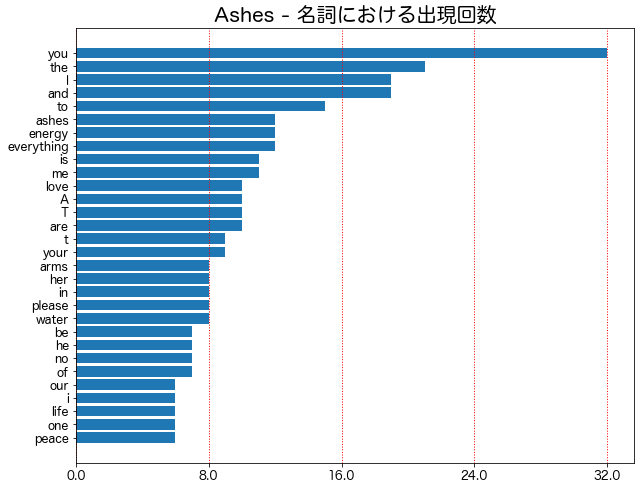

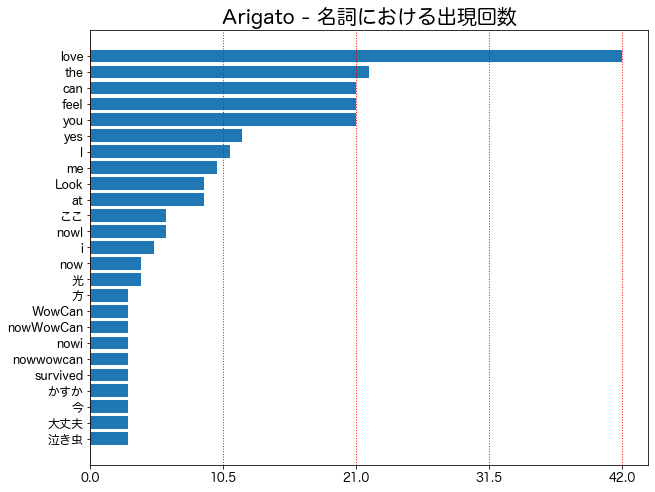

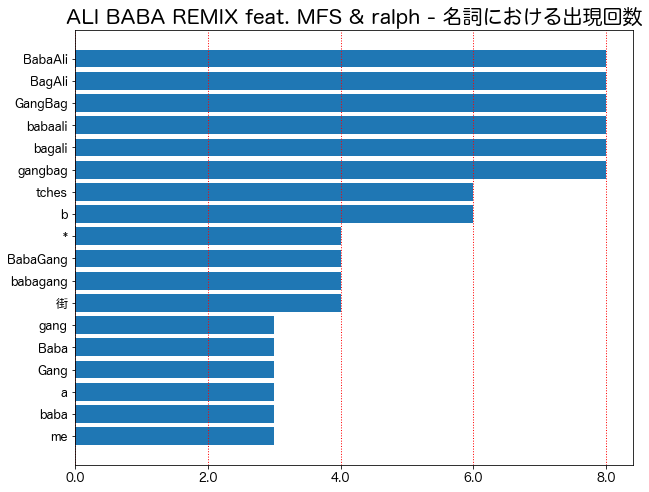

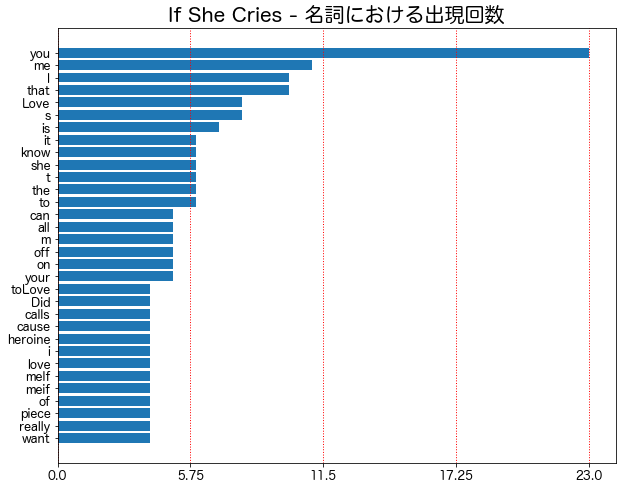

...

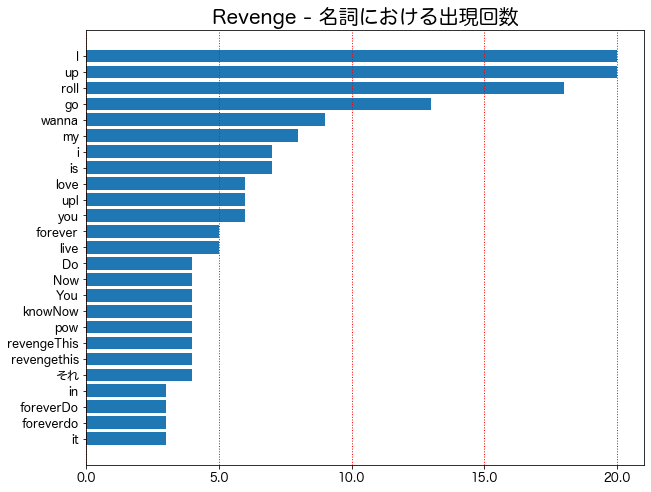

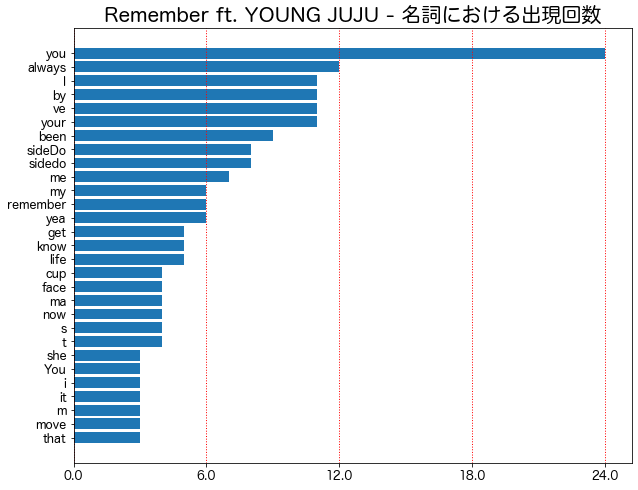

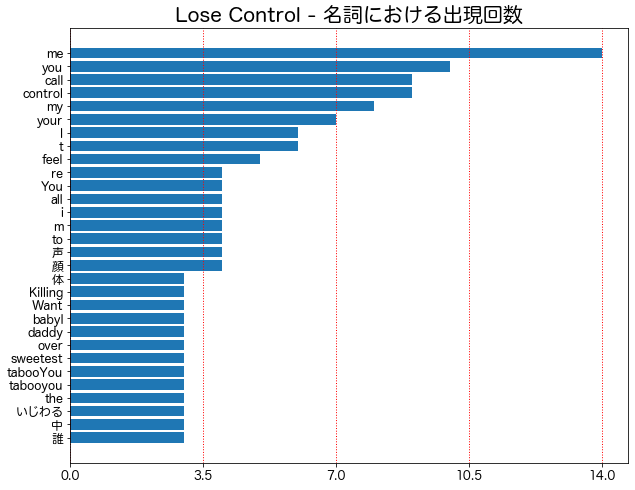

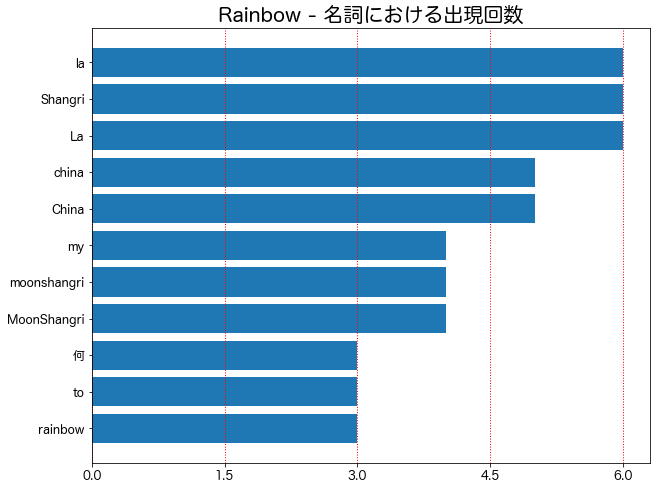

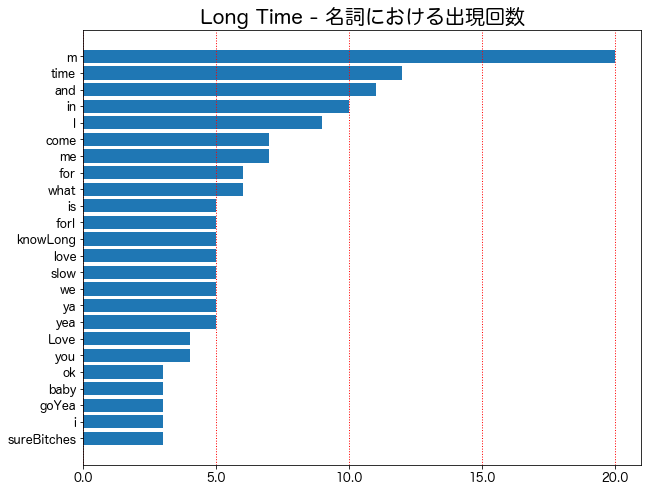

In [17]:
wdcnt_graph_show("名詞")

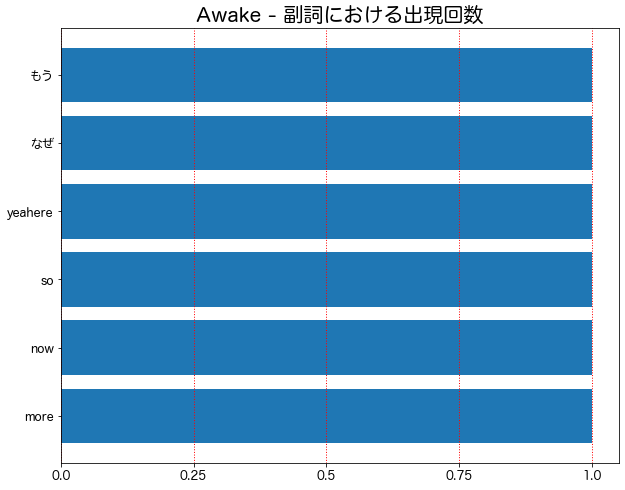

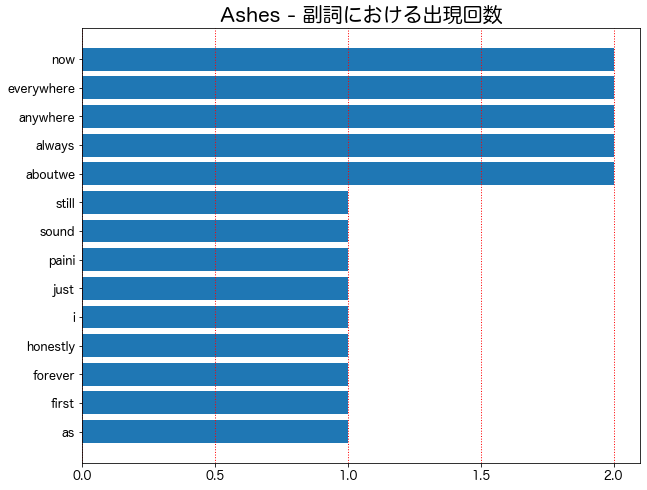

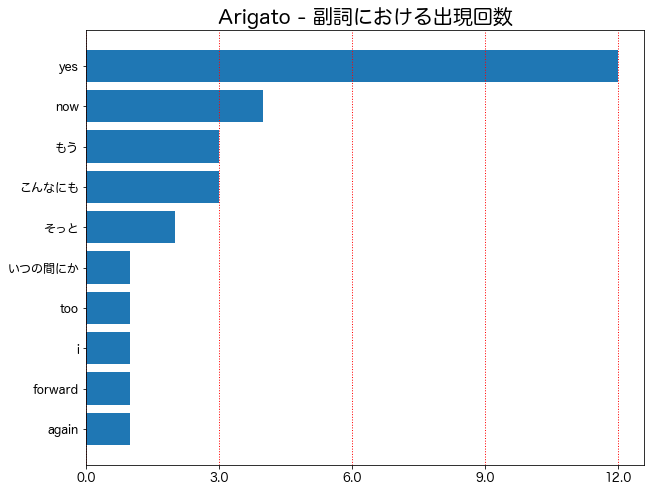

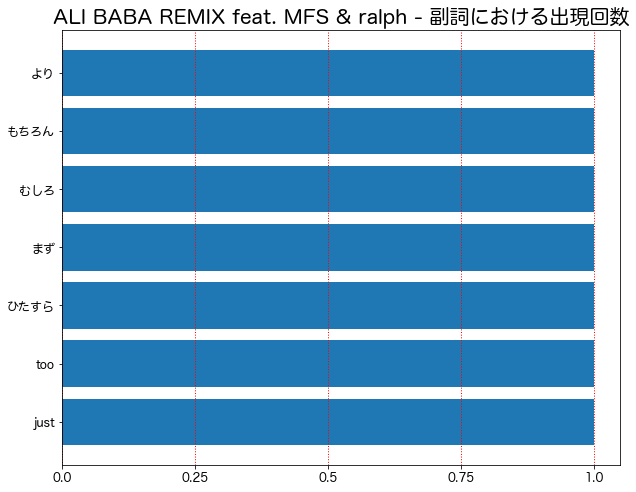

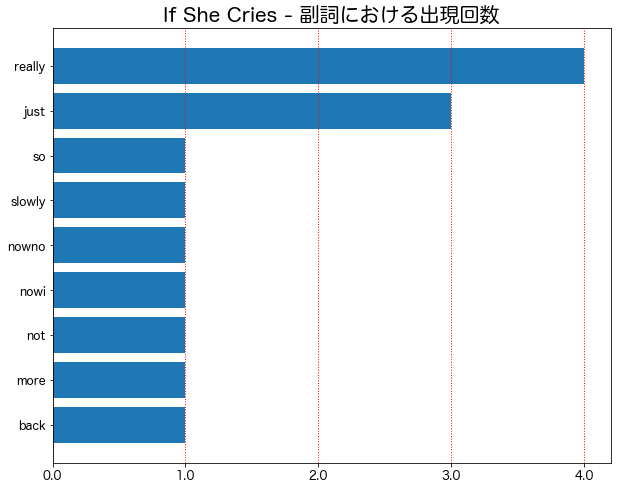

...

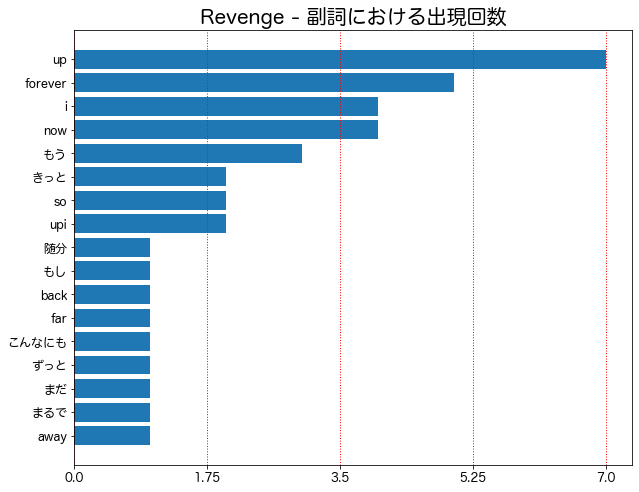

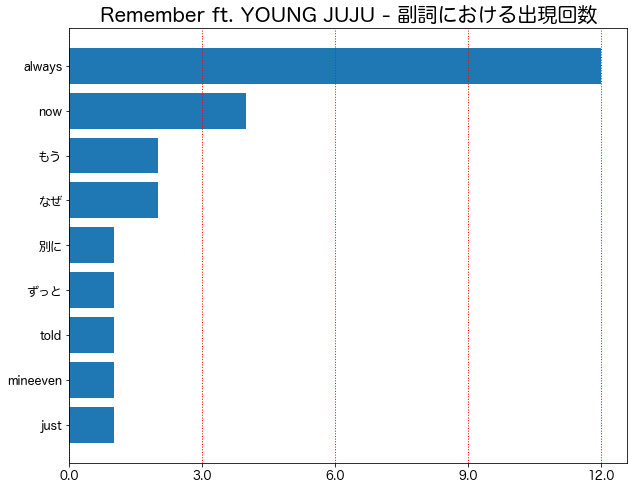

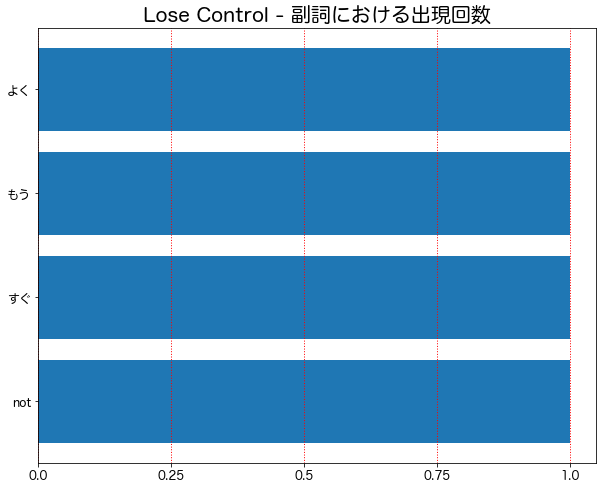

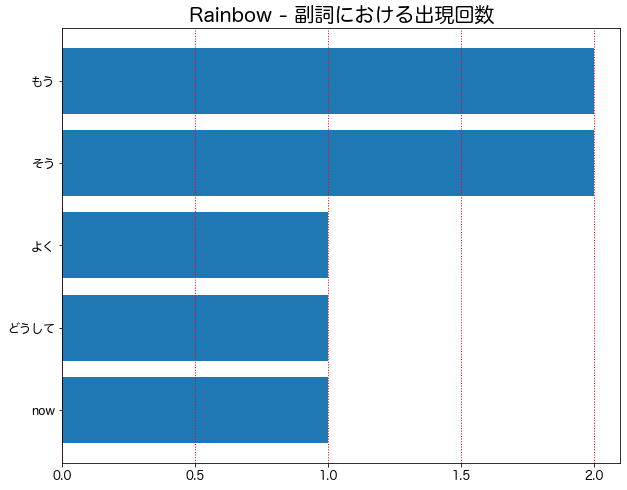

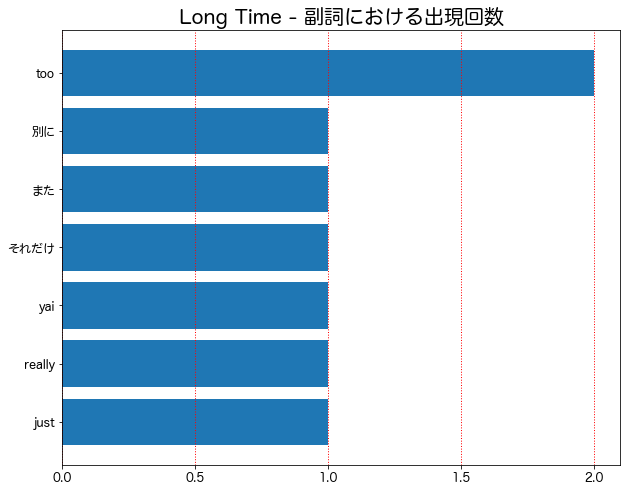

In [14]:
wdcnt_graph_show("副詞")

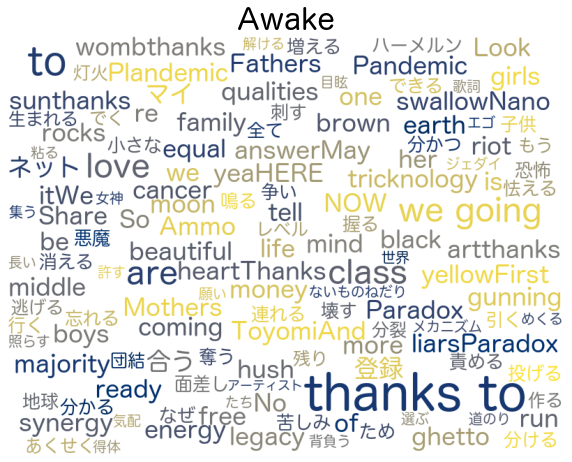

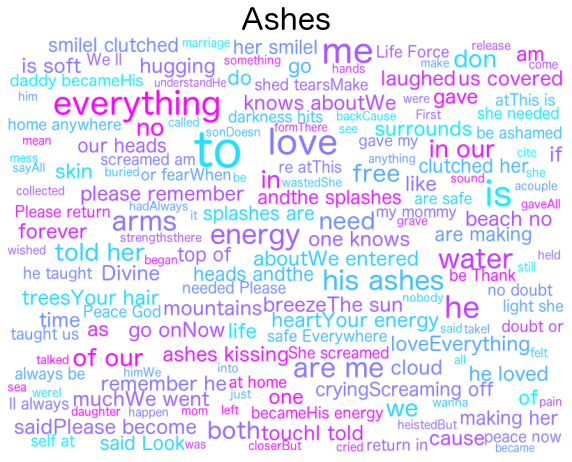

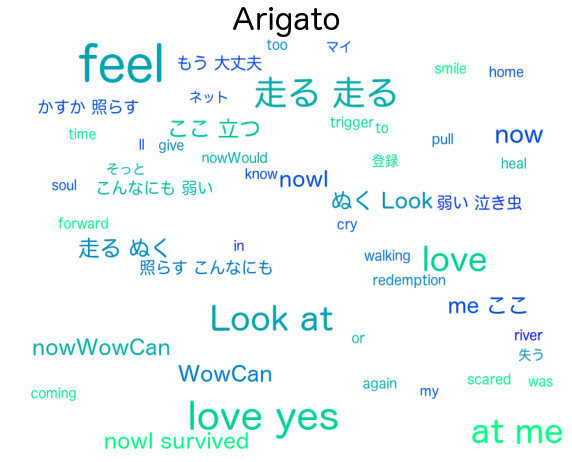

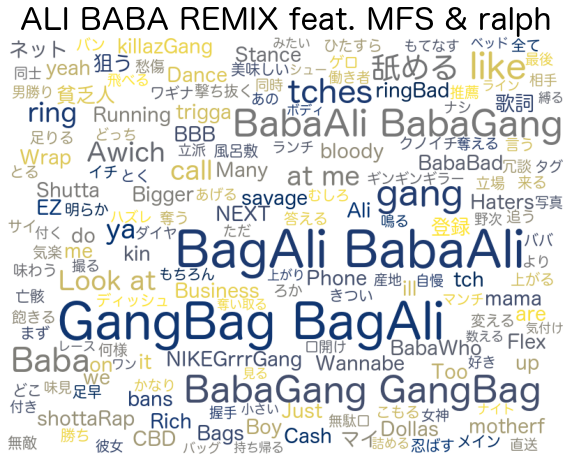

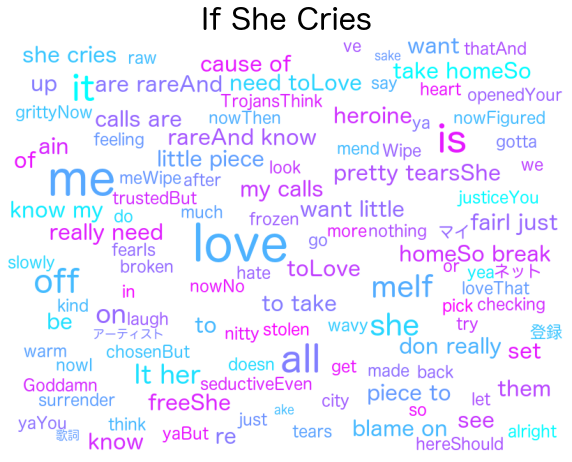

...

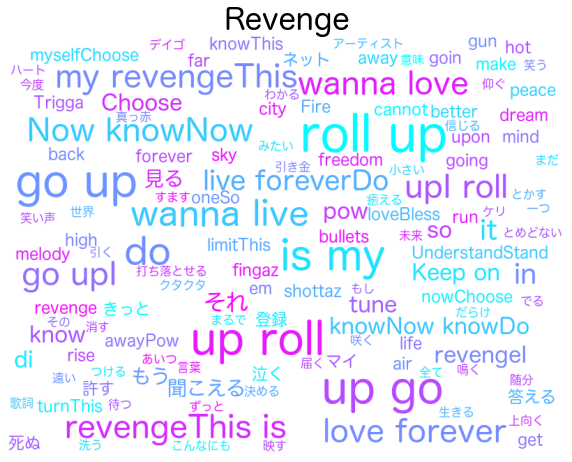

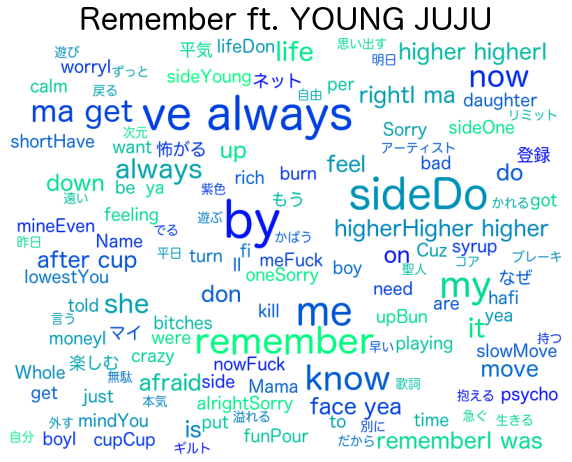

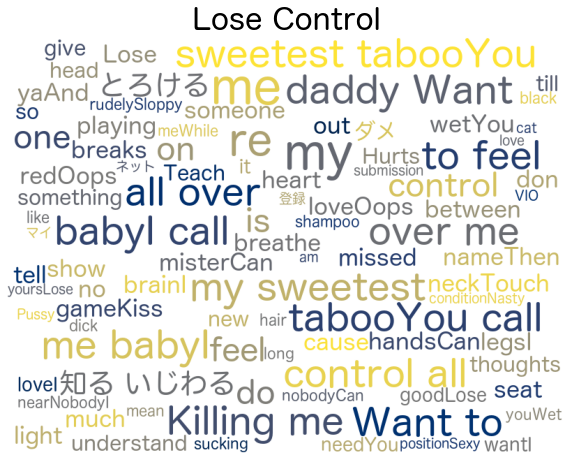

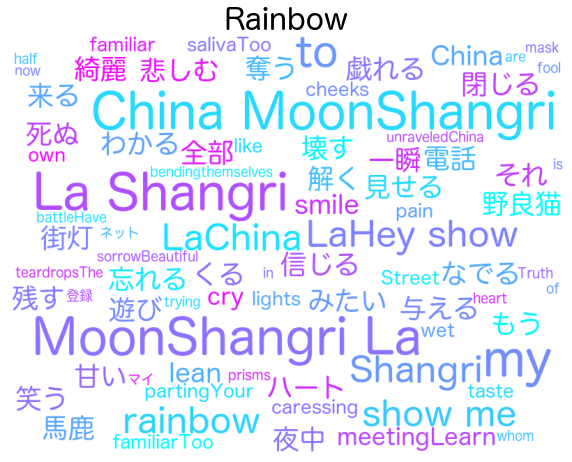

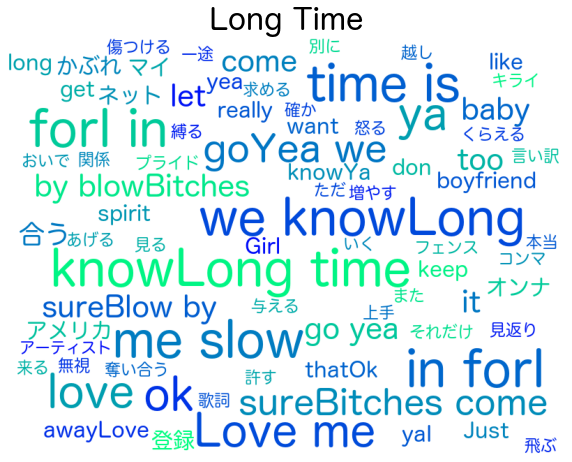

In [18]:
import os
import matplotlib.pyplot as plt
from wordcloud import WordCloud

# 指定された曲の分かち書きされた歌詞を一つの文字列として返す関数
def get_lyrics(song_id):
    lyrics_join = song_dict[song_id]['lyric_wds_join']
    return lyrics_join

# WordCloudのパラメーターを設定
my_font_path = '/System/Library/Fonts/ヒラギノ丸ゴ ProN W4.ttc'  # ここにはシステムにインストールされている日本語フォントのパスを指定してください
stop_wds = ['こと', 'そう', 'ない', 'いい', 'くれる', 'この', '何', 'ある', 'よう', 'ちゃう', 'まま', 'もの', 
            'the', 'and', 'for', 'with', 'but', 'not', 'you', 'your', 'about', 'from', 'they', 'will', 'this', 
            'that', 'there', 'which', 'would', 'can', 'could', 'should', 'these', 'those', 'been', 'their', 
            'what', 'when', 'where', 'who', 'why', 'how', 'its', 'here', 'have', 'has', 'had', 'did', 'does']

color_list = ['cividis', 'cool_r', 'winter']

# 曲ごとにWordCloudを表示
for idx, song_id in enumerate(song_id_list):
    # 曲データを取得
    lyrics_join = get_lyrics(song_id)

    # テーマカラー
    theme_color = color_list[idx % len(color_list)]

    # インスタンスを生成
    word_cloud = WordCloud(
        font_path=my_font_path,  # フォントファイルのパス
        background_color='white',
        colormap=theme_color,
        width=800,
        height=600,
        stopwords=set(stop_wds),
        max_words=200,
        min_font_size=15,
        max_font_size=70,
        prefer_horizontal=1  # 横書きで配置
    )

    # 文字列を与えてWordCloud画像を生成
    output_img = word_cloud.generate(lyrics_join)

    # WordCloudを描画
    plt.figure(figsize=(10, 8))
    plt.imshow(output_img)
    plt.axis('off')
    plt.title(song_dict[song_id]['song_name'], fontsize=30)
    plt.show()
